This workbook shows many of the core features in Tables in an fairly large example that involves real world wrangling with data.  It takes two large data sets from the Berkeley Open Data Portal - the city wide parcel data base and the business license database.  It begins by doing some visualization on maps of the parcel data.  Digging into this reveals the wrangling challenge of working with native data - Use Codes are literally all over the map.  It illustrates some structured techniques for doing the wrangling that leave behind a clear definition of how the raw data is transformed into workable parcel data.  It then joins the residential portion of the parcel data with the business license data to answer a simple question - do people with business licenses live in larger homes?  Yes, enough bigger for a study.

First, a couple of preliminaries that will be in all our notebooks

In [1]:
from datascience import *
import numpy as np
import matplotlib.pyplot as plots
plots.style.use('fivethirtyeight')
%matplotlib inline
# datascience version number of last run of this notebook
version.__version__

'0.3.dev19'

We've grabbed a big chunk of data from the recent Berkeley Open Data portal, so let's read it in as a Table.

https://data.cityofberkeley.info/browse

In [2]:
raw_parcels = Table.read_table("./data/BerkeleyData/Parcels.csv")

Cool, what does that look like.  Tables print themselves in nice HTML format.

In [3]:
raw_parcels

CONDO,APN,POINT_X,POINT_Y,LocationID,StreetNum,Prequalifi,Direction,StreetName,StreetSufx,Unit,City,State,Zip,UseCode,UseCodeDes,BldgSqft,LotSqft,latitude,longitude,X_min,X_max,Y_min,Y_max,Shape_area,Shape_len
YES,055 183213100,565028,4.19089e+06,71843,2550,nan,nan,DANA,ST,nan,BERKELEY,CA,94704,7390,CONDOMINIUM-COMMON AREA,0,0,37.8632,-122.261,565007,565050,4.19088e+06,4.19091e+06,1018.78,129.821
YES,053 166004000,562508,4.19004e+06,67007,1012,nan,nan,GRAYSON,ST,A,BERKELEY,CA,94710,4200,INDUSTRIAL LIGHT/MANUFAC.,1932,1667,37.8557,-122.289,562497,562520,4.19002e+06,4.19006e+06,476.854,92.7454
YES,053 166004200,562508,4.19004e+06,67009,1012,nan,nan,GRAYSON,ST,C,BERKELEY,CA,94710,4101,CONDOMINIUM-INDUSTRIAL,1932,1667,37.8557,-122.289,562497,562520,4.19002e+06,4.19006e+06,476.854,92.7454
YES,057 209002100,562032,4.19171e+06,47615,1813,nan,nan,NINTH,ST,nan,BERKELEY,CA,94710,7300,CONDOMINIUMS-SINGLE RESDL,972,2600,37.8707,-122.295,562012,562053,4.1917e+06,4.19172e+06,483.811,103.162
YES,057 208303100,562499,4.19172e+06,12322,1901,nan,nan,CURTIS,ST,nan,BERKELEY,CA,94702,7300,CONDOMINIUMS-SINGLE RESDL,786,2700,37.8708,-122.289,562483,562515,4.19171e+06,4.19173e+06,533.749,96.0604
YES,052 152702400,564234,4.18923e+06,65546,1829,nan,nan,SIXTY-THIRD,ST,nan,BERKELEY,CA,94703,7300,CONDOMINIUMS-SINGLE RESDL,1387,2363,37.8483,-122.27,564226,564243,4.18921e+06,4.18926e+06,438.797,103.952
YES,052 157310800,565682,4.19013e+06,48709,2641,nan,nan,WEBSTER,ST,1,BERKELEY,CA,94705,7300,CONDOMINIUMS-SINGLE RESDL,630,1167,37.8562,-122.253,565672,565692,4.19011e+06,4.19014e+06,413.513,89.6718
YES,052 151603400,563132,4.18952e+06,65541,1314,nan,nan,HASKELL,ST,A,BERKELEY,CA,94702,1160,SINGLE FAMILY RESIDENTIAL,935,1575,37.851,-122.282,563120,563144,4.1895e+06,4.18955e+06,570.197,116.043
YES,055 183203100,565019,4.19095e+06,7145,2522,nan,nan,DANA,ST,101,BERKELEY,CA,94704,9300,MEDICAL-DENTAL BUILDING,1228,1270,37.8637,-122.261,564998,565040,4.19093e+06,4.19097e+06,1034.69,130.691
YES,056 200500400,563426,4.19151e+06,47852,2122,nan,nan,JEFFERSON,AVE,nan,BERKELEY,CA,94703,7340,"CONDOMINIUM-SFR,R&T 402.1",1403,2166,37.8689,-122.279,563369,563480,4.19142e+06,4.19161e+06,16800.6,587.516


How many parcels are we talking about here?

In [4]:
raw_parcels.num_rows

28805

*Tables are ordered collections of labeled columns.*

How many columns and what are their names?  You can tell by inspection above.  But you also need to be able get at it programmatically.  (Be sure to try command completion with tab.)

In [5]:
raw_parcels.column_labels

('CONDO',
 'APN',
 'POINT_X',
 'POINT_Y',
 'LocationID',
 'StreetNum',
 'Prequalifi',
 'Direction',
 'StreetName',
 'StreetSufx',
 'Unit',
 'City',
 'State',
 'Zip',
 'UseCode',
 'UseCodeDes',
 'BldgSqft',
 'LotSqft',
 'latitude',
 'longitude',
 'X_min',
 'X_max',
 'Y_min',
 'Y_max',
 'Shape_area',
 'Shape_len')

In [6]:
# Len of a table is the number of columns
len(raw_parcels)

26

This table seems to contain geocoded data, since it has columns called latitude and longitude.  Let's just assume that is what's going on and throw all 28,000 points on a map. We can even label the points in case you click on them.

In [7]:
raw_parcels.points('latitude','longitude')

We can also easily do some descriptive statistics on the Table to try to figure out what we are looking at.  We might want to select some useful columns and plot that.

First, select.  This returns a new table with the selected columns.

In [8]:
parcels = raw_parcels.select(('APN', 'BldgSqft','LotSqft'))

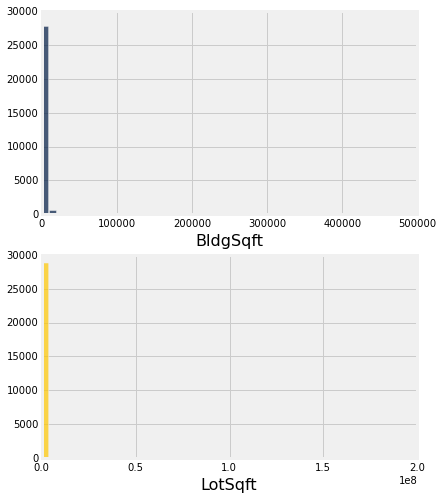

In [9]:
# Table.hist shows a histogram of the data in each of the columns
parcels.select(('BldgSqft','LotSqft')).hist(bins=50)

Well, that's not terrible useful.  Seems we have a very long tail on this distribution.  We might want to look at some of this data.  We get a better sense by sorting and plotting.

Sort also returns a new table

In [10]:
sorted_parcels = parcels.sort('BldgSqft', descending=True)
sorted_parcels

APN,BldgSqft,LotSqft
054 177300304,470587,742601
054 174800201,360996,625771
052 157308707,337730,84800
055 189700501,281496,115103
054 177000801,274722,444431
053 165200105,263476,449649
057 205401201,245629,69261
056 195500600,225513,74710
053 165500900,202214,308807
057 202601203,193269,30702


Yep, big industrial properties with half a million sq ft.  Here's a bit more.

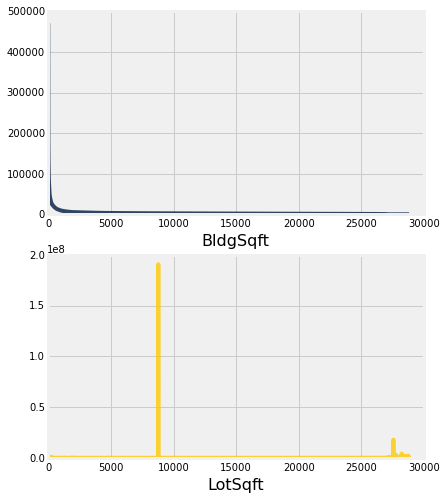

In [11]:
sorted_parcels.select(('BldgSqft','LotSqft')).plot()

In [12]:
parcels.select(('BldgSqft','LotSqft')).stats()

statistic,BldgSqft,LotSqft
min,0,0
max,470587,1.90724e+08
median,1885,5000
sum,8.74759e+07,4.2726e+08


If we are going to make much sense of the data, we will have to break it down into useful categories and do analysis within those.  

Each of the columns in a Table can be selected to get a column of values.

In [13]:
raw_parcels['UseCodeDes']

array(['CONDOMINIUM-COMMON AREA', 'INDUSTRIAL LIGHT/MANUFAC.',
       'CONDOMINIUM-INDUSTRIAL', ..., 'SINGLE FAMILY RESIDENTIAL',
       'SINGLE FAMILY RESIDENTIAL', 'EXEMPT PUBLIC AGENCIES'], dtype=object)

OK, so how many use codes and descriptions do we have?

In [14]:
use_codes = np.unique(raw_parcels['UseCode'])
len(use_codes)

98

In [15]:
use_desc = np.unique(raw_parcels['UseCodeDes'])
len(use_desc)

95

Isn't that interesting.  There must be some places where the same description has multiple different codes! We could already start grouping things by usecode, but 100 codes is still a lot to deal with.  Guess we get to do some wrangling.  Grouping may still be handy because we will see can find the most common one.

In [16]:
parcels_by_use = raw_parcels.select(('APN','UseCode','UseCodeDes')).group('UseCode')
parcels_by_use

UseCode,APN,UseCodeDes
300,['056 200507900' '057 211900100' '060 251200300' '052 15 ...,['EXEMPT PUBLIC AGENCIES' 'EXEMPT PUBLIC AGENCIES' 'EXEM ...
400,['057 203401402' '060 236001001'],['LEASED TO PUBLIC UTILITY' 'LEASED TO PUBLIC UTILITY']
500,['052 143901400' '052 151902600' '052 151400800' '053 16 ...,['OWNED BY PUBLIC UTILITY' 'OWNED BY PUBLIC UTILITY' 'O ...
750,['060 900800700' '060 900801000' '060 900801100' '060 90 ...,['FLOATING HOME' 'FLOATING HOME' 'FLOATING HOME' 'FLOATI ...
1000,['056 197702300' '056 197702400' '052 152400200' '052 15 ...,['VACANT RES LAND <=4 UNITS' 'VACANT RES LAND <=4 UNITS' ...
1040,['057 201500900'],"['VACANT RES LAND, R&T402.1']"
1100,"['052 156707900' '058 218205000' '052 143501200' ..., '0 ...",['SINGLE FAMILY RESIDENTIAL' 'SINGLE FAMILY RESIDENTIAL' ...
1101,['055 190802800'],['SINGLE FAMILY RESIDENTIAL']
1120,['053 161100800' '053 167701000' '055 184003400'],['RESDL IMPR ON COMML LAND' 'RESDL IMPR ON COMML LAND' ...
1130,['056 196204800' '053 163501001' '053 163502000'],['SINGLE FAMILY RESIDENTIAL' 'SINGLE FAMILY RESIDENTIAL' ...


Now that's interesting.  Much more information that 'GROUP BY' in SQL and things like that because the entries in the table are lists of values in the group.  Notice that 1100 and 1101 are both "SINGLE FAMILY RESIDENTIAL".  

We can provide a collection function to combine these values into one.


In [17]:
use_codes = raw_parcels.select(('APN','UseCodeDes')).group('UseCodeDes', len)
use_codes

UseCodeDes,APN len
1 TO 5 STORY OFFICE BLDG.,162
2 UNITS-LESSER QUAL 22,899
"2,3 OR 4 UNITS W/ ROOMING",45
"2,3,OR 4 SINGLE FAM HOMES",666
3 UNITS-LESSER QUAL 23,341
4 UNITS-LESSER QUAL 24,179
5+SINGLE FAMILY RES HOMES,2
> 1 MOBILE OR MH W/ RESDL,1
AUTOMOBILE DEALERSHIP,11
BANK,19


Now we can sort that.  Notice that the label for the collected column reflects ow we got here.

In [18]:
common_uses = use_codes.sort('APN len', descending=True)
common_uses.max_str_rows = 20
common_uses

UseCodeDes,APN len
SINGLE FAMILY RESIDENTIAL,16568
CONDOMINIUMS-SINGLE RESDL,1921
MULTIPLE RESIDL BLDG. 5+U,1161
DOUBLE OR DUPLEX TYPE- 2U,976
2 UNITS-LESSER QUAL 22,899
"2,3,OR 4 SINGLE FAM HOMES",666
CONDOMINIUM-COMMON AREA,511
FOURPLEX OR TRIPLEX W/SFR,509
VACANT RES LAND <=4 UNITS,491
EXEMPT PUBLIC AGENCIES,396


Let's pull out the 16,568 'SINGLE FAMILY RESIDENTIAL' parcels.

Unlike select, we want the rows of the table WHERE some particular property holds.

In [19]:
residential = raw_parcels.where(raw_parcels['UseCodeDes'] == 'SINGLE FAMILY RESIDENTIAL')

In [20]:
residential.points('latitude','longitude')

Well, that is more useful.  We might like to understand what portion of the parcels are 'SINGLE FAMILY RESIDENTIAL".  It would be nice to visualize that too.  This brings us to one of the key observations.  We have a real programming language around tables and we are learning how to use it.  For example we might define a simple function.

In [21]:
parcels = raw_parcels.select(['APN','UseCode','UseCodeDes','BldgSqft','LotSqft','latitude','longitude'])

Not only can we use columns of a table by indexing them with their label, we can introduce new columns.  Let's apply our color function to every description to get a color for each row.

Tables can also be used to construct handy data tools for doing operations on tables.

In [22]:
categories = Table.from_rows([("Residential",["RESIDENTIAL", "SFR", "SINGLE RESDL", "SINGLE FAM"], "blue"),
                              ("Multi-unit", ["UNIT", "FRAT", "SORO"], "orange"),
                              ("Industrial", ["INDUSTRIAL"], "red"),
                              ("Commercial", ["COMMERCIAL", "DEALERSHIP","BANK", "RESTAURANT", "STORE","MARKET",
                                              "SHOP", "OFFICE", "FUNERAL", "THEATER"], "green"),
                              ("Public", ["PUBLIC", "SCHOOL"], "yellow")],
                             ("Category", "Keys", "Color"))
categories

Category,Keys,Color
Residential,"['RESIDENTIAL', 'SFR', 'SINGLE RESDL', 'SINGLE FAM']",blue
Multi-unit,"['UNIT', 'FRAT', 'SORO']",orange
Industrial,['INDUSTRIAL'],red
Commercial,"['COMMERCIAL', 'DEALERSHIP', 'BANK', 'RESTAURANT', 'STOR ...",green
Public,"['PUBLIC', 'SCHOOL']",yellow


Lots of other opportunities to talk about defining functions, scoping, higher order functions.  This one is in the yechy of 70s style of global scope.  But we don't have lambda yet.

In [23]:
def categorize (title) : 
    for category, keywords, _ in categories.rows:
        for word in keywords :
            if title.find(word) >= 0 : return category
    return 'Other'

Try it out

In [24]:
categorize("SINGLE FAMILY RESIDENTIAL")

'Residential'

In [25]:
parcels['Category'] = parcels.apply(categorize, 'UseCodeDes')
parcels

APN,UseCode,UseCodeDes,BldgSqft,LotSqft,latitude,longitude,Category
055 183213100,7390,CONDOMINIUM-COMMON AREA,0,0,37.8632,-122.261,Other
053 166004000,4200,INDUSTRIAL LIGHT/MANUFAC.,1932,1667,37.8557,-122.289,Industrial
053 166004200,4101,CONDOMINIUM-INDUSTRIAL,1932,1667,37.8557,-122.289,Industrial
057 209002100,7300,CONDOMINIUMS-SINGLE RESDL,972,2600,37.8707,-122.295,Residential
057 208303100,7300,CONDOMINIUMS-SINGLE RESDL,786,2700,37.8708,-122.289,Residential
052 152702400,7300,CONDOMINIUMS-SINGLE RESDL,1387,2363,37.8483,-122.27,Residential
052 157310800,7300,CONDOMINIUMS-SINGLE RESDL,630,1167,37.8562,-122.253,Residential
052 151603400,1160,SINGLE FAMILY RESIDENTIAL,935,1575,37.851,-122.282,Residential
055 183203100,9300,MEDICAL-DENTAL BUILDING,1228,1270,37.8637,-122.261,Other
056 200500400,7340,"CONDOMINIUM-SFR,R&T 402.1",1403,2166,37.8689,-122.279,Residential


Let's try to get a sense of how our catorigorization did.

In [26]:
for cat, des in parcels.select(["UseCodeDes","Category"]).group('Category', np.unique).rows:
    print(cat,des)

Commercial ['1 TO 5 STORY OFFICE BLDG.' 'AUTOMOBILE DEALERSHIP' 'BANK'
 'COMMERCIAL REPAIR GARAGE' 'CONDO - COMMERCIAL RETAIL'
 'CONDO-OFFICE, COMMON AREA' 'CONDOMINIUM-OFFICE' 'DEPARTMENT STORE'
 'DISCOUNT STORE' 'FUNERAL HOME' 'HISTORICAL COMMERCIAL'
 'MISC. IMPROVED COMMERCIAL' 'ONE STORY STORE' 'OVER 5 STORY OFFICE BLDG.'
 'RESTAURANT' 'SHOPPING CENTER - NBHD' 'STORE 1ST FLR W/ OFF/APTS'
 'SUPERMARKET' 'VETERINARIAN OFFICE' 'WALK IN THEATER']
Industrial ['CONDO-INDUSTRIAL,COM AREA' 'CONDOMINIUM-INDUSTRIAL' 'HEAVY INDUSTRIAL'
 'INDUSTRIAL FLEX/R&D USE' 'INDUSTRIAL LIGHT/MANUFAC.'
 'MISC INDUSTRIAL(IMPROVED)' 'VACANT INDUSTRIAL/IMPROVE']
Multi-unit ['2 UNITS-LESSER QUAL 22' '2,3 OR 4 UNITS W/ ROOMING'
 '3 UNITS-LESSER QUAL 23' '4 UNITS-LESSER QUAL 24'
 'FRATERNITIES/SORORITIES' 'RES.PROP.CONVERT 5+ UNITS'
 'VACANT APT. LAND 5+ UNITS' 'VACANT RES LAND <=4 UNITS']
Other ['> 1 MOBILE OR MH W/ RESDL' 'CAR WASH' 'CHURCH' 'CHURCH HOME'
 'CONDO COMML - COMMON AREA' 'CONDO-COMMON LIVE/WORK'


In [27]:
colored = parcels.join('Category', categories)
colored.sort('BldgSqft', descending=True)

Category,APN,UseCode,UseCodeDes,BldgSqft,LotSqft,latitude,longitude,Keys,Color
Industrial,054 177300304,4300,HEAVY INDUSTRIAL,470587,742601,37.8589,-122.296,['INDUSTRIAL'],red
Industrial,054 174800201,4300,HEAVY INDUSTRIAL,360996,625771,37.8556,-122.295,['INDUSTRIAL'],red
Industrial,054 177000801,4300,HEAVY INDUSTRIAL,274722,444431,37.8572,-122.296,['INDUSTRIAL'],red
Commercial,053 165200105,3300,MISC. IMPROVED COMMERCIAL,263476,449649,37.8531,-122.288,"['COMMERCIAL', 'DEALERSHIP', 'BANK', 'RESTAURANT', 'STOR ...",green
Public,057 205401201,300,EXEMPT PUBLIC AGENCIES,245629,69261,37.8722,-122.271,"['PUBLIC', 'SCHOOL']",yellow
Commercial,053 165500900,9400,1 TO 5 STORY OFFICE BLDG.,202214,308807,37.8539,-122.293,"['COMMERCIAL', 'DEALERSHIP', 'BANK', 'RESTAURANT', 'STOR ...",green
Commercial,057 202601203,9500,OVER 5 STORY OFFICE BLDG.,193269,30702,37.8697,-122.269,"['COMMERCIAL', 'DEALERSHIP', 'BANK', 'RESTAURANT', 'STOR ...",green
Public,055 187900601,300,EXEMPT PUBLIC AGENCIES,189867,32685,37.8672,-122.259,"['PUBLIC', 'SCHOOL']",yellow
Public,057 202302003,300,EXEMPT PUBLIC AGENCIES,175500,34267,37.8705,-122.27,"['PUBLIC', 'SCHOOL']",yellow
Industrial,053 164400701,4200,INDUSTRIAL LIGHT/MANUFAC.,173288,168141,37.8515,-122.295,['INDUSTRIAL'],red


In [28]:
colored.points('latitude', 'longitude', labels='UseCodeDes', colors='Color')

Ok, so let's do some more detailed analysis on the residential part, now that we see where it is.

In [29]:
residential = parcels.where(parcels['Category'] == 'Residential')

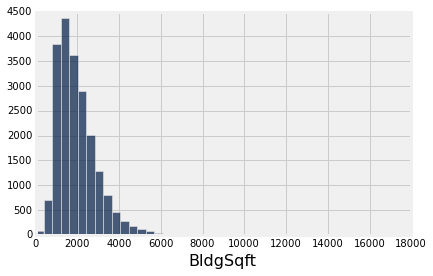

In [30]:
residential.select(['BldgSqft']).hist(bins=40)

In [31]:
residential.select(['BldgSqft','LotSqft']).stats()

statistic,BldgSqft,LotSqft
min,0,0
max,16264,138114
median,1775,4800
sum,4.13872e+07,1.07552e+08


In [32]:
def firstQtile(x) : return np.percentile(x,25)
def thirdQtile(x) : return np.percentile(x,25)
summary_ops = (min, firstQtile, np.median, np.mean, thirdQtile, max)

In [33]:
residential.select(['BldgSqft','LotSqft']).stats(summary_ops)

statistic,BldgSqft,LotSqft
min,0,0
firstQtile,1272,3600
median,1775,4800
mean,1985.28,5159.13
thirdQtile,1272,3600
max,16264,138114


In [34]:
residential['Size'] = ['small' if x < 3000 else 'large' for x in residential['BldgSqft'] ]
residential

APN,UseCode,UseCodeDes,BldgSqft,LotSqft,latitude,longitude,Category,Size
057 209002100,7300,CONDOMINIUMS-SINGLE RESDL,972,2600,37.8707,-122.295,Residential,small
057 208303100,7300,CONDOMINIUMS-SINGLE RESDL,786,2700,37.8708,-122.289,Residential,small
052 152702400,7300,CONDOMINIUMS-SINGLE RESDL,1387,2363,37.8483,-122.27,Residential,small
052 157310800,7300,CONDOMINIUMS-SINGLE RESDL,630,1167,37.8562,-122.253,Residential,small
052 151603400,1160,SINGLE FAMILY RESIDENTIAL,935,1575,37.851,-122.282,Residential,small
056 200500400,7340,"CONDOMINIUM-SFR,R&T 402.1",1403,2166,37.8689,-122.279,Residential,small
058 217002900,7300,CONDOMINIUMS-SINGLE RESDL,973,2250,37.8755,-122.273,Residential,small
059 228904100,7300,CONDOMINIUMS-SINGLE RESDL,801,3100,37.874,-122.291,Residential,small
059 229005800,7300,CONDOMINIUMS-SINGLE RESDL,910,2688,37.874,-122.291,Residential,small
058 217502700,7300,CONDOMINIUMS-SINGLE RESDL,979,2041,37.876,-122.271,Residential,small


# Joining data sets

In [35]:
biz = Table.read_table("./data/BerkeleyData/Business_Licenses.csv")

In [36]:
biz

APN,Minority_Owned,Female_Owned,RecordID,BusDesc,B1_PER_SUB_TYPE,B1_APPL_STATUS,DBA,NAICS,Tax_Code,Employee_Num,Bus_Own_Type,B1_BUSINESS_NAME,B1_ADDRESS1,B1_ADDRESS2,B1_CITY,B1_STATE,B1_ZIP,B1_CONTACT_TYPE,B1_FULL_ADDRESS,B1_SITUS_CITY,B1_SITUS_STATE,B1_SITUS_ZIP,InDbDate,Business_Location
052 155900100,nan,nan,BL-038949,CONSULTING-ENGINEER,Business Personal Repair Svs,Unreported,WILLIAM J. CAIN,nan,nan,nan,nan,nan,2510 PRINCE ST,nan,BERKELEY,CA,94705,Business Owner,2510 PRINCE ST,BERKELEY,CA,94705,06/10/2015 03:30:21 AM,"2510 PRINCE ST BERKELEY, CA 94705 (37.854112933000067, - ..."
056 198304201,No,No,BL-001767,AUTO REPAIR & SERVICE,Business Personal Repair Svs,Delinquent,BEYOND REPAIR JAPANESE,nan,B,4,nan,nan,2147 SAN PABLO AVE,nan,BERKELEY,CA,94702,Business Owner,2147 SAN PABLO AVE,BERKELEY,CA,94702,06/10/2015 03:30:08 AM,"2147 SAN PABLO AVE BERKELEY, CA 94702 (37.86698046400005 ..."
057 203100900,No,No,BL-029009,LAW OFFICE,Professional SemiProfessional,Closed,RUMBERGER TIMOTHY P LAW OFFICE,445110 - Supermarkets and Other Grocery (except Convenie ...,P,0,Sole Ownership,nan,1339 BAY ST,nan,ALAMEDA,CA,94501,Business Owner,2161 SHATTUCK AVE,BERKELEY,CA,94704,06/10/2015 03:30:17 AM,"2161 SHATTUCK AVE BERKELEY, CA 94704 (37.870098538000036 ..."
055 182201800,No,Yes,BL-046854,PSYCHOTHERAPY OFFICE,Professional SemiProfessional,Active,WEKSLER ORIT MFT,621330 - Offices of Mental Health Practitioners (except ...,P,1,Sole Ownership,nan,923 BALRA DRIVE,nan,EL CERRITO,CA,94530,Business Owner,2000 DWIGHT WAY D,BERKELEY,CA,94704,06/10/2015 03:30:26 AM,"2000 DWIGHT WAY D BERKELEY, CA 94704 (37.863643455000044 ..."
058 217301900,No,Yes,BL-043569,RENTAL PROPERTY,Rental of Real Property,Closed,NORLUND BRIDGET,531110 - Lessors of Residential Buildings and Dwellings,L,0,Corporation,nan,574 MONTGOMERY ST,nan,NAPA,CA,94559,Business Owner,1601 MILVIA ST,BERKELEY,CA,94709,06/10/2015 03:30:24 AM,"1601 MILVIA ST BERKELEY, CA 94709 (37.877974384000026, - ..."
057 202800400,nan,nan,BL-000393,ATTORNE AT LAW,Business Personal Repair Svs,Unreported,ANDERSON & DROSSEL,nan,nan,nan,nan,nan,"2041 BANCROFT WAY, SUITE 207",nan,KENSINGTON,CA,94704,Business Owner,2041 BANCROFT WAY 207,BERKELEY,CA,94704,06/10/2015 03:30:06 AM,"2041 BANCROFT WAY 207 BERKELEY, CA 94704 (37.86745577600 ..."
063 298303101,No,Yes,BL-052271,ECONOMIC CONSULTING,Professional SemiProfessional,Active,VERNAZZA WOLFE ASSOCIATES INC,541690 - Other Scientific and Technical Consulting Services,P,1,Corporation,nan,2909 SHASTA RD,nan,BERKELEY,CA,94708-2117,Business Owner,2909 SHASTA RD,BERKELEY,CA,94708,06/10/2015 03:30:31 AM,"2909 SHASTA RD BERKELEY, CA 94708 (37.888940650000052, - ..."
054 180802000,No,No,BL-011440,GRAPHIC ARTS,Professional SemiProfessional,Active,STINEHOUR CHRISTOPHER,541430 - Graphic Design Services,P,1,Sole Ownership,nan,1701 PARKER STREET,nan,BERKELEY,CA,94703,Business Owner,1701 PARKER ST,BERKELEY,CA,94703,06/10/2015 03:30:12 AM,"1701 PARKER ST BERKELEY, CA 94703 (37.861098065000078, - ..."
ZZZZZZZZZZZZZ,No,Yes,BL-045996,RECYCLING WASTE DIVERSION,Business Personal Repair Svs,Active,GREEN MARY LLC,562998 - All Other Miscellaneous Waste Management Services,B,10,Corporation,nan,PO BOX 4957,nan,SANTA ROSA,CA,95402,Business Owner,0 VARIOUS,BERKELEY,CA,94704,06/10/2015 03:30:26 AM,"0 VARIOUS BERKELEY, CA 94704 (37.86651629000005, -122.26 ..."
nan,nan,nan,BL-000763,GENEAL CONTRACTOR,Construction or Contractor,Active,EAST BAY CONSTTRUCTION,236118 - Residential Remodelers,C,0,Sole Ownership,EAST BAY CONSTRUCTION,2817 WENDELL AVE,nan,RICHMOND,CA,94804-1361,Business Owner,0 VARIOUS,BERKELEY,CA,94704,06/10/2015 03:30:06 AM,"0 VARIOUS BERKELEY, CA 94704 (37.86651629000005, -122.26 ..."


In [37]:
biz_residential = residential.join('APN', biz)

In [38]:
biz_residential

APN,UseCode,UseCodeDes,BldgSqft,LotSqft,latitude,longitude,Category,Size,Minority_Owned,Female_Owned,RecordID,BusDesc,B1_PER_SUB_TYPE,B1_APPL_STATUS,DBA,NAICS,Tax_Code,Employee_Num,Bus_Own_Type,B1_BUSINESS_NAME,B1_ADDRESS1,B1_ADDRESS2,B1_CITY,B1_STATE,B1_ZIP,B1_CONTACT_TYPE,B1_FULL_ADDRESS,B1_SITUS_CITY,B1_SITUS_STATE,B1_SITUS_ZIP,InDbDate,Business_Location
016 141404600,1100,SINGLE FAMILY RESIDENTIAL,450,731,37.8531,-122.258,Residential,small,No,Yes,BL-053881,MARKETING SERVICE,Professional SemiProfessional,Active,TLS MARKETING SERVICES LLC,541613 - Marketing Consulting Services,P,0,LLC,nan,2418 WOOLSEY ST,nan,BERKELEY,CA,94705,Business Owner,2418 WOOLSEY ST,BERKELEY,CA,94705,06/10/2015 03:30:33 AM,"2418 WOOLSEY ST BERKELEY, CA 94705 (37.85322337100007, - ..."
048H766303700,1100,SINGLE FAMILY RESIDENTIAL,0,810,37.8575,-122.239,Residential,small,Yes,Yes,BL-049484,WINE IMPORT/WHOLESALE,Wholesale Trade,Active,VINOSUR LLC,424820 - Wine and Distilled Alcoholic Beverage Merchant ...,W,2,LLC,nan,617 ALVARADO RD,nan,BERKELEY,CA,94705,Business Owner,617 ALVARADO RD,BERKELEY,CA,94705,06/10/2015 03:30:29 AM,"617 ALVARADO RD BERKELEY, CA 94705 (37.857804843000054, ..."
052 136400300,2400,FOURPLEX OR TRIPLEX W/SFR,4789,4120,37.8489,-122.269,Residential,large,No,No,BL-013577,RENTALS 16 ROOMS,Rental of Real Property,Active,VINCENT F OSMAN,531110 - Lessors of Residential Buildings and Dwellings,L,0,nan,nan,1920 ALCATRAZ AVE,nan,BERKELEY,CA,94703,Business Owner,1918 ALCATRAZ AVE,BERKELEY,CA,94703,06/10/2015 03:30:13 AM,"1918 ALCATRAZ AVE BERKELEY, CA 94703 (37.849072852000063 ..."
052 141001402,2400,FOURPLEX OR TRIPLEX W/SFR,3772,7749,37.8517,-122.253,Residential,large,Yes,Yes,BL-041295,RES RENTAL PROPERTY/4 UNITS,Rental of Real Property,Active,WU JOHNNY & MONICA,531110 - Lessors of Residential Buildings and Dwellings,L,0,Partnership,nan,3158 COLLEGE AVE APT 4,nan,BERKELEY,CA,94705-2748,Business Owner,3158 COLLEGE AVE,BERKELEY,CA,94705,06/10/2015 03:30:22 AM,"3158 COLLEGE AVE BERKELEY, CA 94705 (37.851777257000037, ..."
052 141003400,2400,FOURPLEX OR TRIPLEX W/SFR,4758,6250,37.8523,-122.253,Residential,large,No,No,BL-004326,APARTMENTS 12 ROOMS,Rental of Real Property,Active,ERDIAKOFF BORIS,531110 - Lessors of Residential Buildings and Dwellings,L,0,Sole Ownership,nan,36711 VIA CICADA,nan,CATHEDRAL CITY,CA,92234,Business Owner,3140 COLLEGE AVE,BERKELEY,CA,94705,06/10/2015 03:30:10 AM,"3140 COLLEGE AVE BERKELEY, CA 94705 (37.852346484000066, ..."
052 141003900,7300,CONDOMINIUMS-SINGLE RESDL,993,1476,37.8519,-122.253,Residential,small,Yes,Yes,BL-051708,ONLINE SHOW- BLOGGING ADVERTISING,Entertainment Recreation,Closed,FLIPTIZZY,516110,E,0,nan,nan,3154 COLLEGE AVE 3,nan,BERKELEY,CA,94705,Business Owner,3154 COLLEGE AVE 3,BERKELEY,CA,94705,06/10/2015 03:30:31 AM,"3154 COLLEGE AVE 3 BERKELEY, CA 94705 (37.85192705400004 ..."
052 142503000,2300,TRIPLEX OR DUPLEX W/ SFR,3406,4950,37.8523,-122.265,Residential,large,No,No,BL-034453,RENTAL PROPERTY/3 UNITS,Rental of Real Property,Active,CURTIN MICHAEL/ICHINOSE A,531110 - Lessors of Residential Buildings and Dwellings,L,0,nan,nan,2126 WOOLSEY ST,nan,BERKELEY,CA,947051831,Business Owner,2126 WOOLSEY ST,BERKELEY,CA,94705,06/10/2015 03:30:19 AM,"2126 WOOLSEY ST BERKELEY, CA 94705 (37.852503195000054, ..."
052 142503200,2100,"2,3,OR 4 SINGLE FAM HOMES",2934,5000,37.8523,-122.265,Residential,small,No,No,BL-005481,GARDENER,Business Personal Repair Svs,Active,GROUNDWORKS GARDENING,561510 - Travel Agencies,B,0,Sole Ownership,nan,2122 WOOLSEY ST,nan,BERKELEY,CA,94705,Business Owner,2122 WOOLSEY ST,BERKELEY,CA,94705,06/10/2015 03:30:10 AM,"2122 WOOLSEY ST BERKELEY, CA 94705 (37.852483606000078, ..."
052 142900200,1100,SINGLE FAMILY RESIDENTIAL,1943,3800,37.852,-122.268,Residential,small,No,No,BL-035716,FRENCH LANGUAGE/CULTURE EDU (NON-PROFIT),Non Profit Organizations,Active,ALLIANCE FRANCAISE DE BERKELEY,611630 - Language Schools,N,9,Corporation,nan,2004 WOOLSEY ST,nan,BERKELEY,CA,94703,Business Owner,2004 WOOLSEY S

In [39]:
biz_residential.select(['latitude', 'longitude']).points('latitude','longitude')

In [40]:
biz_residential.num_rows

2629

What fraction of residential properties have business licenses?

In [41]:
biz_residential.num_rows / residential.num_rows

0.1261092723173598

In [42]:
residential.select(['BldgSqft','LotSqft']).stats(summary_ops)

statistic,BldgSqft,LotSqft
min,0,0
firstQtile,1272,3600
median,1775,4800
mean,1985.28,5159.13
thirdQtile,1272,3600
max,16264,138114


In [43]:
biz_residential.select(['BldgSqft','LotSqft']).stats(summary_ops)

statistic,BldgSqft,LotSqft
min,0,426
firstQtile,1566,4000
median,2233,5000
mean,2433.89,5388.37
thirdQtile,1566,4000
max,12555,43134


In [44]:
bins = np.insert(np.arange(500,6000,100),0,0)
bins

array([   0,  500,  600,  700,  800,  900, 1000, 1100, 1200, 1300, 1400,
       1500, 1600, 1700, 1800, 1900, 2000, 2100, 2200, 2300, 2400, 2500,
       2600, 2700, 2800, 2900, 3000, 3100, 3200, 3300, 3400, 3500, 3600,
       3700, 3800, 3900, 4000, 4100, 4200, 4300, 4400, 4500, 4600, 4700,
       4800, 4900, 5000, 5100, 5200, 5300, 5400, 5500, 5600, 5700, 5800,
       5900])

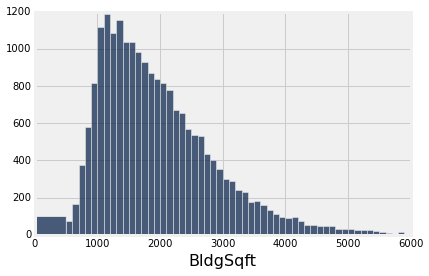

In [45]:
residential.select(['BldgSqft']).hist(bins=bins)

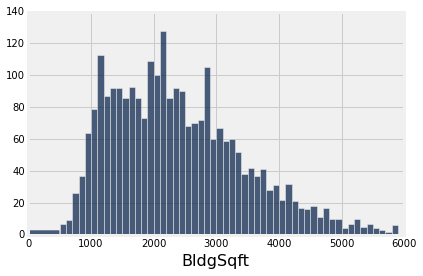

In [46]:
biz_residential.select(['BldgSqft']).hist(bins=bins)

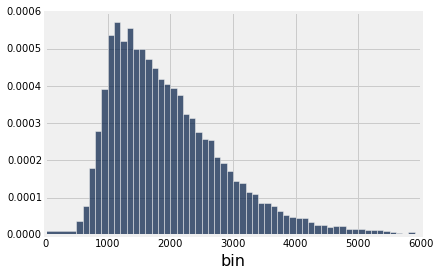

In [47]:
res_dist = residential.select(['BldgSqft']).bin(bins=bins, normed=True)
res_dist.hist(counts='bin', bins='bin')

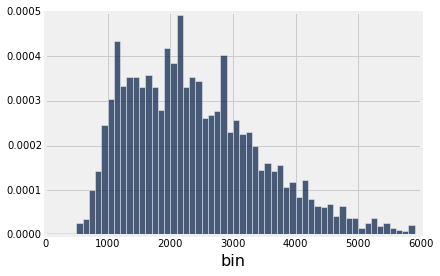

In [48]:
biz_dist = biz_residential.select(['BldgSqft']).bin(bins=bins, normed=True)
biz_dist.hist(counts='bin', bins='bin')

In [49]:
biz_dist

bin,BldgSqft density
0,2.30415e-06
500,2.68817e-05
600,3.45622e-05
700,9.98464e-05
800,0.000142089
900,0.000245776
1000,0.000303379
1100,0.000433948
1200,0.000334101
1300,0.000353303


In [50]:
res_dist['Biz Bldg Sqft'] = biz_dist['BldgSqft density']
res_dist.relabel('BldgSqft density','Res Bldg Sqft')
res_dist

bin,Res Bldg Sqft,Biz Bldg Sqft
0,9.3503e-06,2.30415e-06
500,3.61481e-05,2.68817e-05
600,7.85618e-05,3.45622e-05
700,0.000180258,9.98464e-05
800,0.000279063,0.000142089
900,0.000392327,0.000245776
1000,0.000538365,0.000303379
1100,0.000572103,0.000433948
1200,0.000521978,0.000334101
1300,0.00055668,0.000353303


In [51]:
res_dist['Var Dist'] = res_dist['Res Bldg Sqft']-res_dist['Biz Bldg Sqft']

In [52]:
res_dist

bin,Res Bldg Sqft,Biz Bldg Sqft,Var Dist
0,9.3503e-06,2.30415e-06,7.04615e-06
500,3.61481e-05,2.68817e-05,9.26634e-06
600,7.85618e-05,3.45622e-05,4.39996e-05
700,0.000180258,9.98464e-05,8.04119e-05
800,0.000279063,0.000142089,0.000136974
900,0.000392327,0.000245776,0.000146551
1000,0.000538365,0.000303379,0.000234986
1100,0.000572103,0.000433948,0.000138156
1200,0.000521978,0.000334101,0.000187877
1300,0.00055668,0.000353303,0.000203378


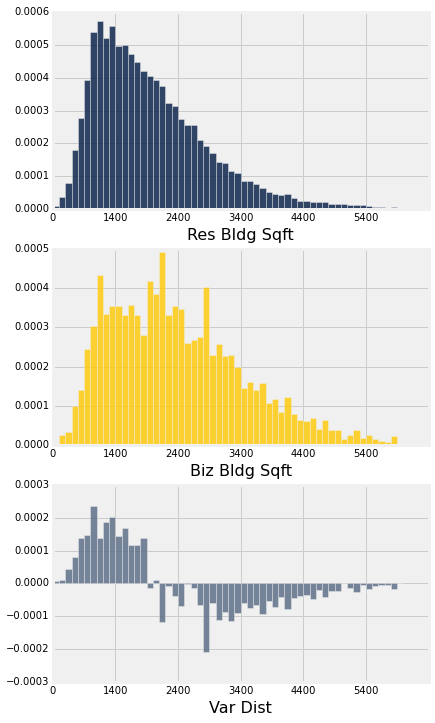

In [53]:
res_dist.bar('bin')

It sure looks like non-biz-license residences tend to be smaller and biz-license residences tend to be larger.

A statistics based entirely on the differences of these normalized histograms is the Total Variational Distance

In [54]:
# Total variational distance
TVD = np.sum(np.abs(res_dist['Var Dist']))
TVD

0.0038034167304116374

In [55]:
res_size = residential.select(['APN','BldgSqft'])
res_size

APN,BldgSqft
057 209002100,972
057 208303100,786
052 152702400,1387
052 157310800,630
052 151603400,935
056 200500400,1403
058 217002900,973
059 228904100,801
059 229005800,910
058 217502700,979


In [56]:
biz_residential.select(['APN','BldgSqft'])

APN,BldgSqft
016 141404600,450
048H766303700,0
052 136400300,4789
052 141001402,3772
052 141003400,4758
052 141003900,993
052 142503000,3406
052 142503200,2934
052 142900200,1943
052 143300400,2598


In [57]:
 "016 141404600" in biz_residential['APN']

True

In [58]:
def is_biz(apn):
    return (apn in biz_residential['APN'])

In [59]:
is_biz("052 136400300")

True

In [60]:
is_biz("052 136400301")

False

In [61]:
res_size['Biz']=res_size.apply(is_biz,'APN')

In [62]:
res_size

APN,BldgSqft,Biz
057 209002100,972,False
057 208303100,786,False
052 152702400,1387,True
052 157310800,630,False
052 151603400,935,False
056 200500400,1403,False
058 217002900,973,False
059 228904100,801,False
059 229005800,910,False
058 217502700,979,False


In [63]:
# compute a statistic on this
print(np.mean(res_size['BldgSqft']))
print(np.mean(res_size.where('Biz')['BldgSqft']))
print(np.mean(res_size.where('Biz',False)['BldgSqft']))

1985.2809517
2433.89235451
1920.5428148


In [64]:
np.mean(res_size.where('Biz',True)['BldgSqft'])-np.mean(res_size.where('Biz',False)['BldgSqft'])

513.34953970886636

In [65]:
# Permuted version of the biz column
permuted_biz = res_size.select(['Biz']).sample()
res_size['pBiz']=permuted_biz['Biz']
res_size

APN,BldgSqft,Biz,pBiz
057 209002100,972,False,True
057 208303100,786,False,True
052 152702400,1387,True,False
052 157310800,630,False,True
052 151603400,935,False,False
056 200500400,1403,False,False
058 217002900,973,False,False
059 228904100,801,False,False
059 229005800,910,False,False
058 217502700,979,False,False


In [66]:
num_permutations = 300
for i in range(num_permutations):
    permuted_biz = res_size.select(['Biz']).sample()
    res_size['pBiz-' + str(i)] = permuted_biz['Biz']
res_size

APN,BldgSqft,Biz,pBiz,pBiz-0,pBiz-1,pBiz-2,pBiz-3,pBiz-4,pBiz-5,pBiz-6,pBiz-7,pBiz-8,pBiz-9,pBiz-10,pBiz-11,pBiz-12,pBiz-13,pBiz-14,pBiz-15,pBiz-16,pBiz-17,pBiz-18,pBiz-19,pBiz-20,pBiz-21,pBiz-22,pBiz-23,pBiz-24,pBiz-25,pBiz-26,pBiz-27,pBiz-28,pBiz-29,pBiz-30,pBiz-31,pBiz-32,pBiz-33,pBiz-34,pBiz-35,pBiz-36,pBiz-37,pBiz-38,pBiz-39,pBiz-40,pBiz-41,pBiz-42,pBiz-43,pBiz-44,pBiz-45,pBiz-46,pBiz-47,pBiz-48,pBiz-49,pBiz-50,pBiz-51,pBiz-52,pBiz-53,pBiz-54,pBiz-55,pBiz-56,pBiz-57,pBiz-58,pBiz-59,pBiz-60,pBiz-61,pBiz-62,pBiz-63,pBiz-64,pBiz-65,pBiz-66,pBiz-67,pBiz-68,pBiz-69,pBiz-70,pBiz-71,pBiz-72,pBiz-73,pBiz-74,pBiz-75,pBiz-76,pBiz-77,pBiz-78,pBiz-79,pBiz-80,pBiz-81,pBiz-82,pBiz-83,pBiz-84,pBiz-85,pBiz-86,pBiz-87,pBiz-88,pBiz-89,pBiz-90,pBiz-91,pBiz-92,pBiz-93,pBiz-94,pBiz-95,pBiz-96,pBiz-97,pBiz-98,pBiz-99,pBiz-100,pBiz-101,pBiz-102,pBiz-103,pBiz-104,pBiz-105,pBiz-106,pBiz-107,pBiz-108,pBiz-109,pBiz-110,pBiz-111,pBiz-112,pBiz-113,pBiz-114,pBiz-115,pBiz-116,pBiz-117,pBiz-118,pBiz-119,pBiz-120,pBiz-121,pBiz-122,pBiz-123,pBiz-124,pBiz-125,pBiz-126,pBiz-127,pBiz-128,pBiz-129,pBiz-130,pBiz-131,pBiz-132,pBiz-133,pBiz-134,pBiz-135,pBiz-136,pBiz-137,pBiz-138,pBiz-139,pBiz-140,pBiz-141,pBiz-142,pBiz-143,pBiz-144,pBiz-145,pBiz-146,pBiz-147,pBiz-148,pBiz-149,pBiz-150,pBiz-151,pBiz-152,pBiz-153,pBiz-154,pBiz-155,pBiz-156,pBiz-157,pBiz-158,pBiz-159,pBiz-160,pBiz-161,pBiz-162,pBiz-163,pBiz-164,pBiz-165,pBiz-166,pBiz-167,pBiz-168,pBiz-169,pBiz-170,pBiz-171,pBiz-172,pBiz-173,pBiz-174,pBiz-175,pBiz-176,pBiz-177,pBiz-178,pBiz-179,pBiz-180,pBiz-181,pBiz-182,pBiz-183,pBiz-184,pBiz-185,pBiz-186,pBiz-187,pBiz-188,pBiz-189,pBiz-190,pBiz-191,pBiz-192,pBiz-193,pBiz-194,pBiz-195,pBiz-196,pBiz-197,pBiz-198,pBiz-199,pBiz-200,pBiz-201,pBiz-202,pBiz-203,pBiz-204,pBiz-205,pBiz-206,pBiz-207,pBiz-208,pBiz-209,pBiz-210,pBiz-211,pBiz-212,pBiz-213,pBiz-214,pBiz-215,pBiz-216,pBiz-217,pBiz-218,pBiz-219,pBiz-220,pBiz-221,pBiz-222,pBiz-223,pBiz-224,pBiz-225,pBiz-226,pBiz-227,pBiz-228,pBiz-229,pBiz-230,pBiz-231,pBiz-232,pBiz-233,pBiz-234,pBiz-235,pBiz-236,pBiz-237,pBiz-238,pBiz-239,pBiz-240,pBiz-241,pBiz-242,pBiz-243,pBiz-244,pBiz-245,pBiz-246,pBiz-247,pBiz-248,pBiz-249,pBiz-250,pBiz-251,pBiz-252,pBiz-253,pBiz-254,pBiz-255,pBiz-256,pBiz-257,pBiz-258,pBiz-259,pBiz-260,pBiz-261,pBiz-262,pBiz-263,pBiz-264,pBiz-265,pBiz-266,pBiz-267,pBiz-268,pBiz-269,pBiz-270,pBiz-271,pBiz-272,pBiz-273,pBiz-274,pBiz-275,pBiz-276,pBiz-277,pBiz-278,pBiz-279,pBiz-280,pBiz-281,pBiz-282,pBiz-283,pBiz-284,pBiz-285,pBiz-286,pBiz-287,pBiz-288,pBiz-289,pBiz-290,pBiz-291,pBiz-292,pBiz-293,pBiz-294,pBiz-295,pBiz-296,pBiz-297,pBiz-298,pBiz-299
057 209002100,972,False,True,False,False,True,False,False,False,False,True,False,True,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,True,False,True,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,True,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True,False,True,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,F

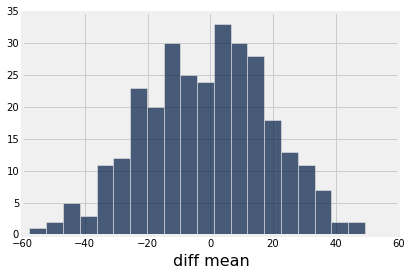

In [67]:
# Under the null hypothesis (biz license is irrelevant) we compute the
# statistic on the many permuted labels under the null hypothesis
null_hypothesis = Table.empty(['diff mean'])
for i in range(num_permutations):
    p = 'pBiz-' + str(i)
    stat = np.mean(res_size.where(p,True)['BldgSqft']) - np.mean(res_size.where(p,False)['BldgSqft'])
    null_hypothesis.append([stat])
null_hypothesis.hist(bins=20)

In [68]:
observation = np.mean(res_size.where('Biz',True)['BldgSqft'])-np.mean(res_size.where('Biz',False)['BldgSqft'])

In [69]:
observation

513.34953970886636

In [70]:
def ptest(x):
    return (x > observation)

In [71]:
null_hypothesis['ptest'] = null_hypothesis.apply(ptest,'diff mean')
null_hypothesis

diff mean,ptest
20.0924,False
-16.929,False
-12.9037,False
40.3312,False
23.8195,False
23.2089,False
-27.6382,False
-0.990495,False
-12.6664,False
25.2132,False


In [72]:
p_value = null_hypothesis.where('ptest').num_rows/num_permutations
p_value

0.0